# Сверточные нейронные сети

In [ ]:
import sys
import warnings

import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm
from tqdm.auto import tqdm

import torch
from torch import nn

import cv2
from PIL import Image

import requests
from io import BytesIO


np.set_printoptions(threshold=sys.maxsize)
plt.rcParams["figure.figsize"] = (20,10)
warnings.filterwarnings("ignore")

Операция свертки:
$$M^{out}(x, y) = \sum_{i=-d}^{d}\sum_{j=-d}^{d}W(d+i,d+j)M^{in}(x+i,y+j)+b,$$
где $M^{out}$ - выходное изображение, $M^{in}$ - входное изображение, $d = \frac{k-1}{2}$, $k$ - размер ядра, $W$ - веса свертки, $b$ - сдвиг (bias)

* Веса $W$ одинаковые для всех участнов изображения
* Каждый пиксель $M^{out}(x, y)$ зависит только от небольшого числа пикселей пространственных размерностей входного изображения $M^{in}$ и ото всех пикселей фичей, соответствующих пространственным значениям

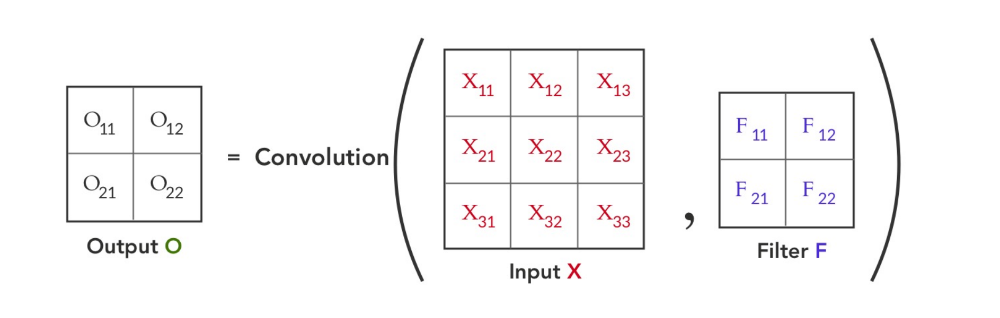

Обычно и входных каналов (фичей), и выходных несколько. Тогда модифицируем формулу:
$$M^{out}(x, y, c_{out}) = \sum_{i=-d}^{d}\sum_{j=-d}^{d}\sum_{c_{in}=1}^{F}W(i,j,c_{in},c_{out})M^{in}(x+i,y+j,c_{in})+b(x,y,c_{out})$$

Теперь веса свертки имеют размерности $[c_{in}, c_{out}, k_h, k_w]$

## Задание
Напишите имплементацию свертки (с шагом 1) для одного канала.

In [ ]:
def conv2d_one_channel(input_matrix, kernel):
  """Имплементация 2-х мерной (для одного канала) свертки (с шагом 1)

  Args:
    input_matrix: 2D numpy.array. Входные данные.
    kernel: 2D numpy.array. Ядро свертки.

  Returns:
    Результат рименения свертки .
  """
  input_height, input_width = input_matrix.shape
  kernel_height, kernel_width = kernel.shape
  output_height = input_height - kernel_height + 1
  output_width = input_width - kernel_width + 1
  output_matrix = np.zeros((output_height, output_width))

  # Ваш код

  for i in range(output_height):
    for j in range(output_width):
      summ = 0.0
      for i1 in range(kernel_height):
        for j1 in range(kernel_width):
          summ += input_matrix[i + i1][j + j1] * kernel[i1][j1]

      output_matrix[i][j] = summ
  return output_matrix

### Пример

In [ ]:
W = np.array([
    [3, 0, -3],
    [10, 0, -10],
    [3, 0, -3]
], dtype=np.float32)

Image format: JPEG; shape: (1023, 682); color scheme: RGB


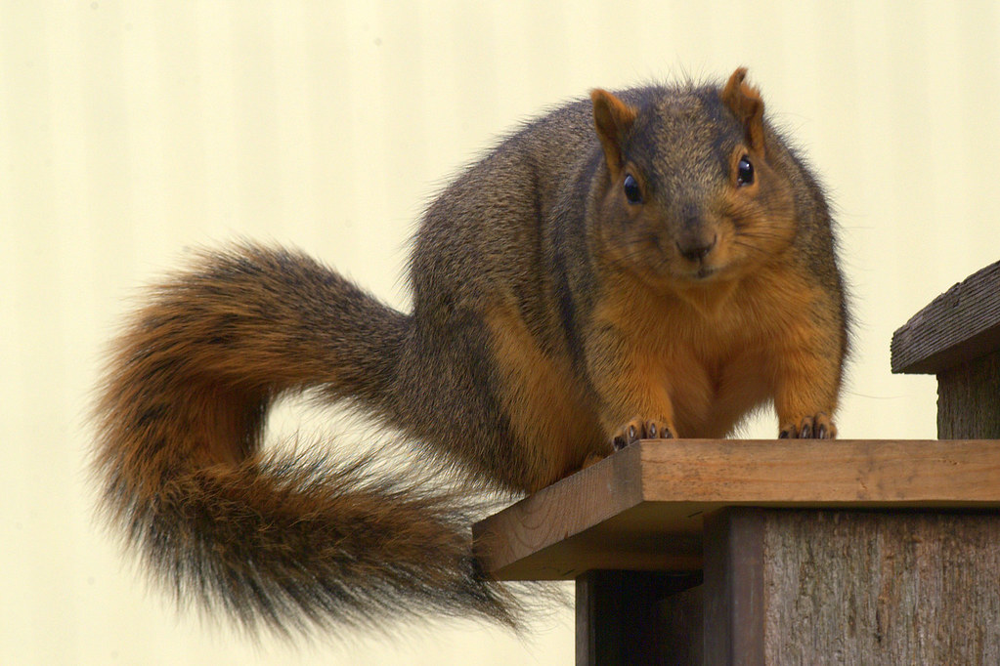

In [ ]:
def load_image_from_url(url: str):
  response = requests.get(url)
  response.raise_for_status()
  img = Image.open(BytesIO(response.content))
  return img

img = load_image_from_url("https://live.staticflickr.com/2218/1936095677_7c800c5b25_b.jpg")
print(f"Image format: {img.format}; shape: {img.size}; color scheme: {img.mode}")
img

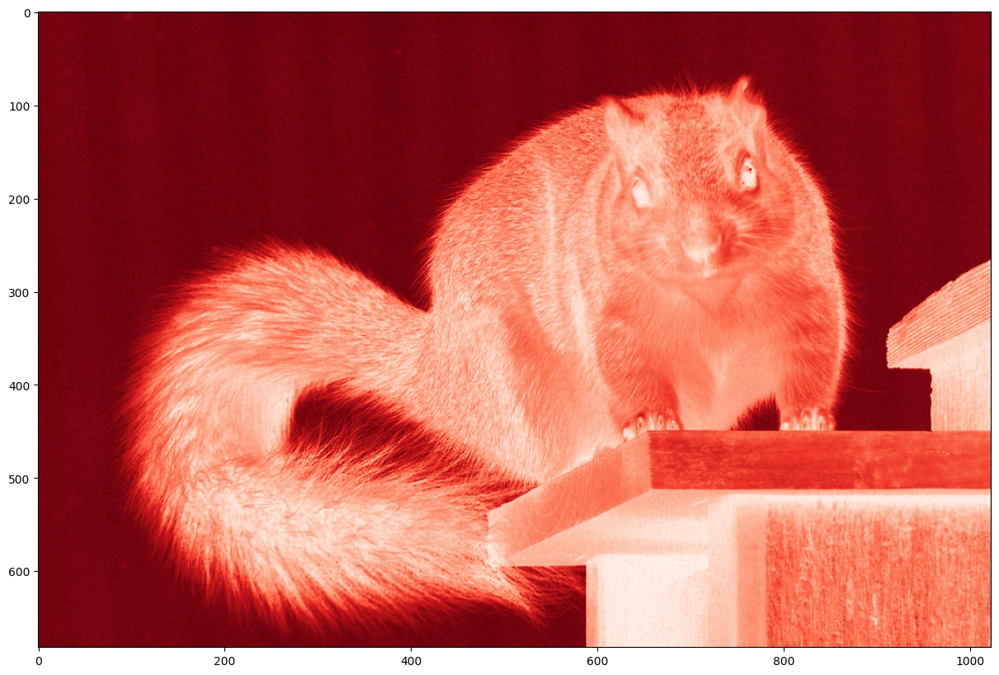

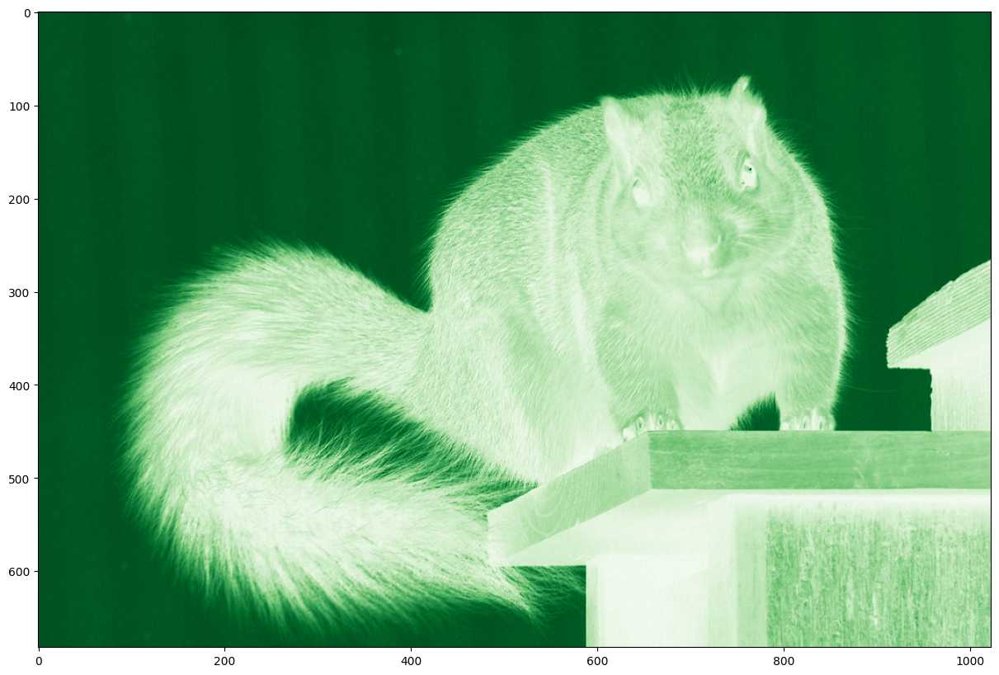

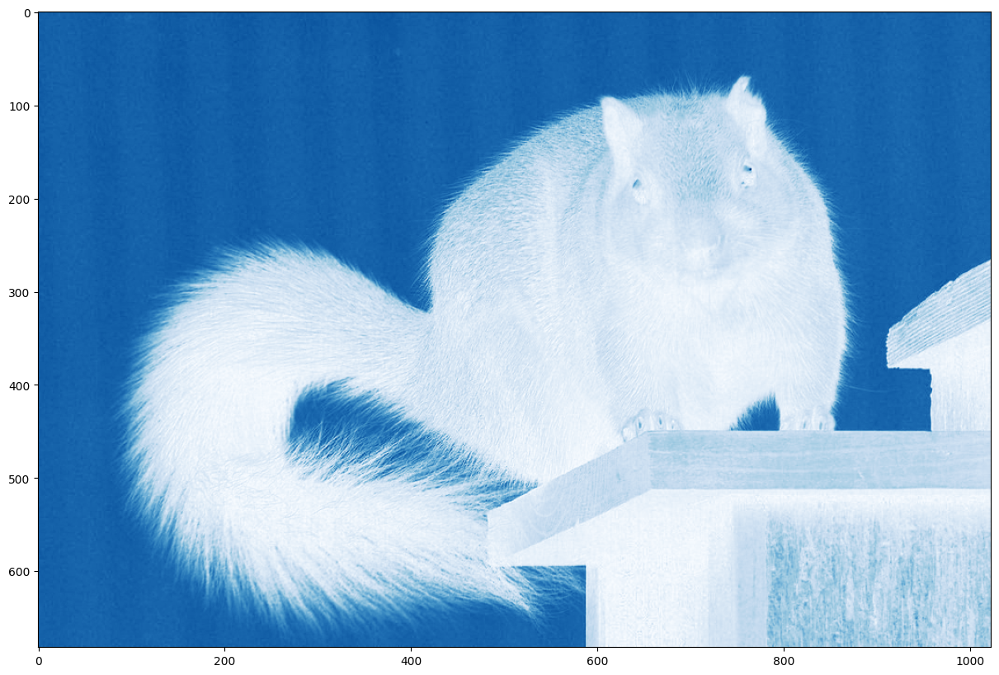

In [ ]:
# PIL.Image в np.ndarray
# формат [H, W, C]
img = np.array(img)

plt.imshow(img[:, :, 0], cmap=cm.Reds)
plt.show()

plt.imshow(img[:, :, 1], cmap=cm.Greens)
plt.show()

plt.imshow(img[:, :, 2], cmap=cm.Blues)
plt.show()

In [ ]:
# возьмем один из каналов исходного изображения
M_in = img[:, :, 0]

M_out = conv2d_one_channel(M_in, W)

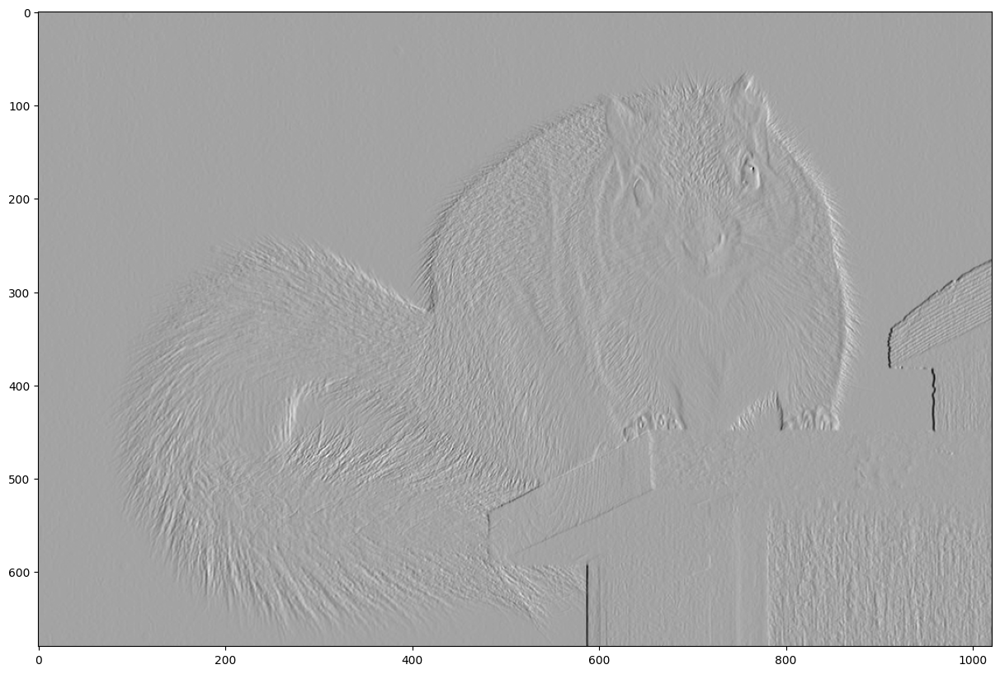

In [ ]:
plt.imshow(M_out, cmap=cm.binary)
plt.show()

## Разновидности сверток

В Pytorch свертка имеет несколько параметров:
```
torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=0,
 dilation=1, groups=1, bias=True, padding_mode='zeros', device=None, dtype=None)
```

Нам интересны **stride, padding, dilation, groups, padding_mode**


----
**Strided convolution**

Stride - размер шага свертки по пространственным осям. У обычной он равен единице.

Давайте посмотрим на пример со `stride=(2,2)`

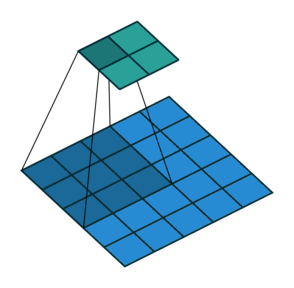

Зачем это нужно:
1. Помогает снижать размер вычислений и быстро уменьшать размер пространственных осей тензора
2. Может выступать альтернативой pooling-слою
3. Помогает увеличить receptive field для свертки следующего слоя (подробнее [computing-receptive-fields](https://distill.pub/2019/computing-receptive-fields/))

------
**Padding**

Добавляем дополнительные элементы ко входному тензору

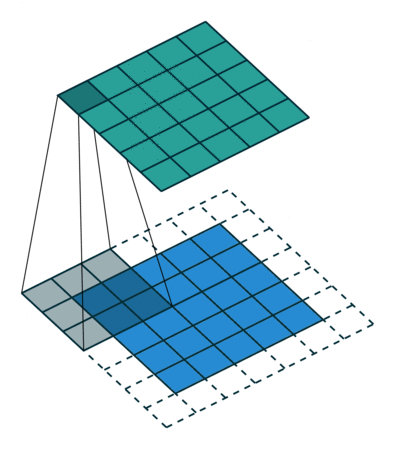

Зачем это нужно:
1. После свертки тензор уменьшается по h и w. Часто этого хотелось бы избежать
2. Без паддинга пиксели на краях не оказывают большого влияния на результат, поскольку свертка "посещает" их меньшее число раз, чем пиксели посредине

---
**Dilaled convolution (разреженная свертка)**

Dilation - это расстояние между элементами ядра

```
dilation (int or tuple, optional) – Spacing between kernel elements. Default: 1

```
1 - означает, что расстояния нет 😃

Рассмотрим пример с `dilation=2`

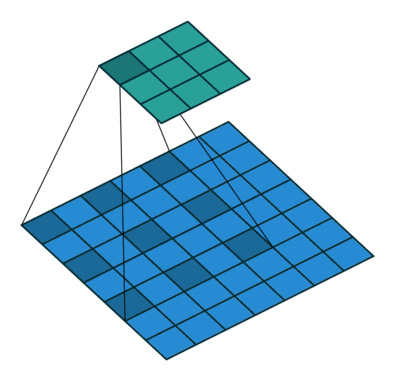

## Pooling-слой

Или слой **субдискретизации**. Помогает быстро сократить пространственные размерности.

Сама идея пулинга такая же, как и у свертки: идем окном по тензору и выполняем какую-то простую операцию. Но есть несколько отличий:
1. Окна не перекрываются между собой
2. Нет обучаемых параметров
3. Обычно выбираем функцию вида **max** или **avg**
4. Входные каналы считаются отдельно друг от друга

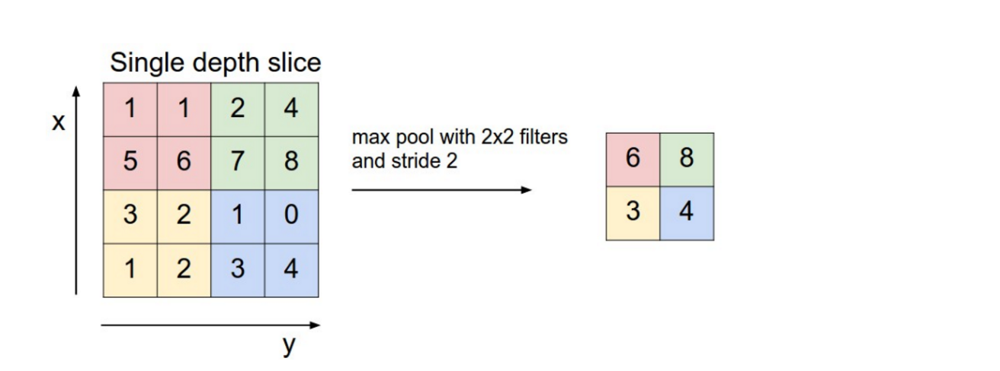

## Композиция сверток в VGG (Visual Geometry Group) (2014)
1. Разложение свертки 5х5 как композиции двух сверток 3х3
2. Это дает дополнительную регуляризацию, делает сеть глубже
3. Умееньшает число весов: $5*5=25$ против $3*3 + 3*3=18$

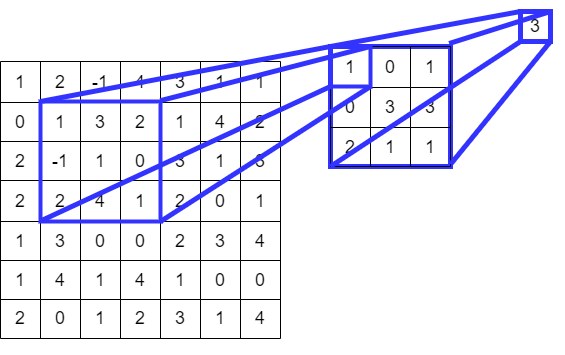

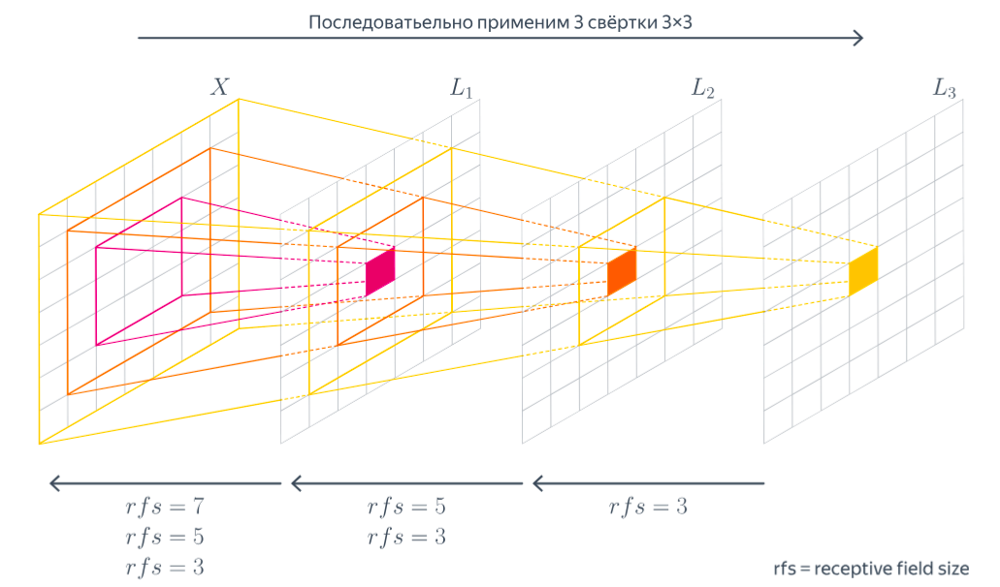

# CNN

## LeNet (1998)

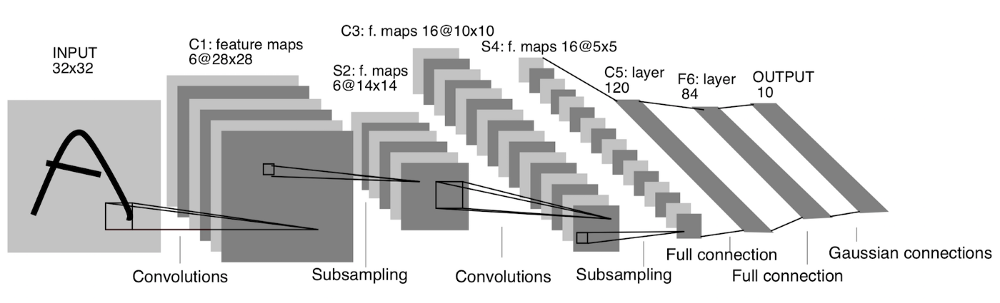

In [ ]:
# Давайте напишем ее самостоятельно

class LeNet(nn.Module):
  def __init__(self):
    super().__init__()

    self.feat = nn.Sequential(
        nn.Conv2d(1, 6, (5, 5)),
        nn.ReLU(True),
        nn.MaxPool2d(2),
        nn.Conv2d(6, 16, 5),
        nn.ReLU(True),
        nn.MaxPool2d(2),
        nn.AdaptiveAvgPool2d((3,3)),
        nn.Flatten(),
    )
    self.cls = nn.Sequential(
        nn.Linear(144, 84),
        nn.ReLU(True),
        nn.Linear(84, 10)
    )

  def forward(self, x):
    x = self.feat(x)
    x = self.cls(x)
    return x

## AlexNet (2012)
Автор - Алекс Крижевски из группы Джеффри Хинтона.

AlexNet положил начало эпохе нейронных сетей

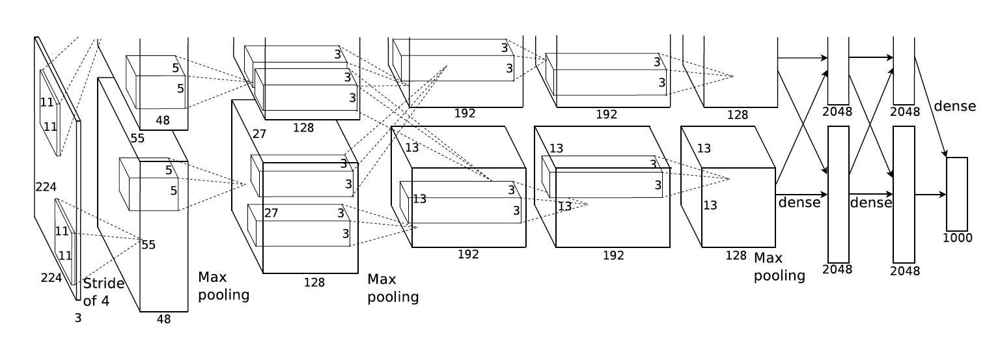

Особенности AlexNet:
1. Первая сеть, обучавшаяся на двух GPU
2. Первая сеть с групповыми свертками - каждая группа обучалась на своей GPU
3. Первая сеть, выигравшая конкурс ImageNet
4. Первая сеть, использовавшая слои нормализации - Local Response Normalization
5. Использовалась аугментация данных

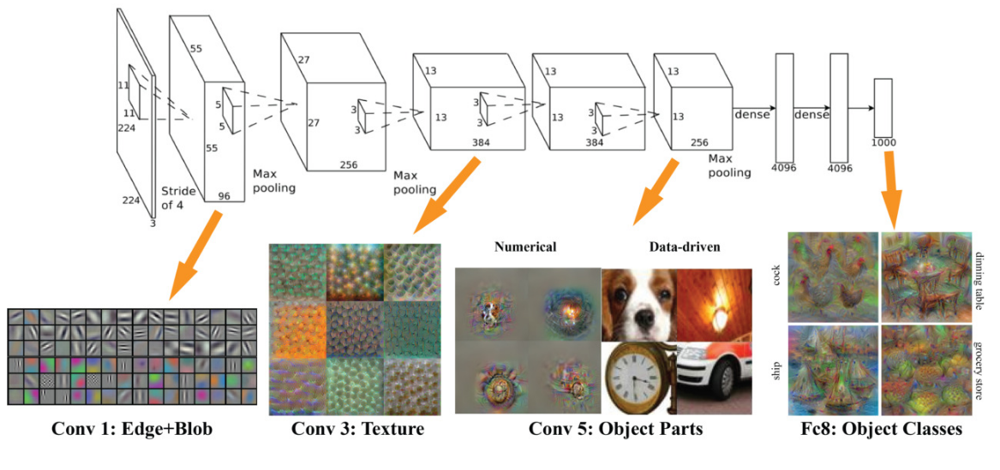

## Inception Google LeNet (2014)

**Auxiliary classifiers**

Глубокие сети сложно обучать, поэтому добавим несколько дополнительных выходов, считающих функцию потерь с верхних слоев:
$L = λ_1L_1(y,z_1) + λ_2L_2(y,z_2) + L_3(y,z)$

Таким образом получается multi-head architechture

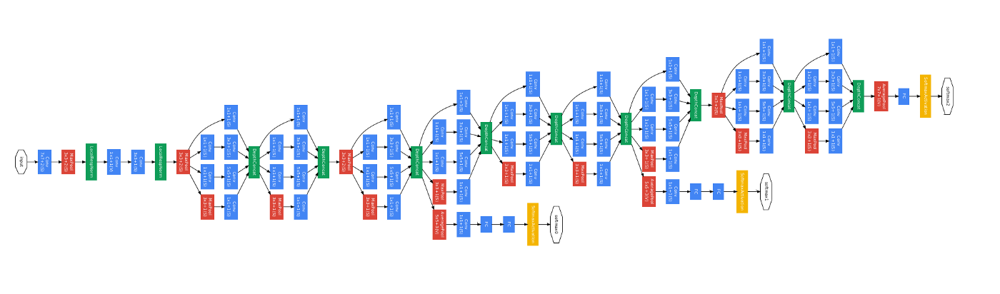

## ResNet (2015)

Глубокие сети плохо обучаются:

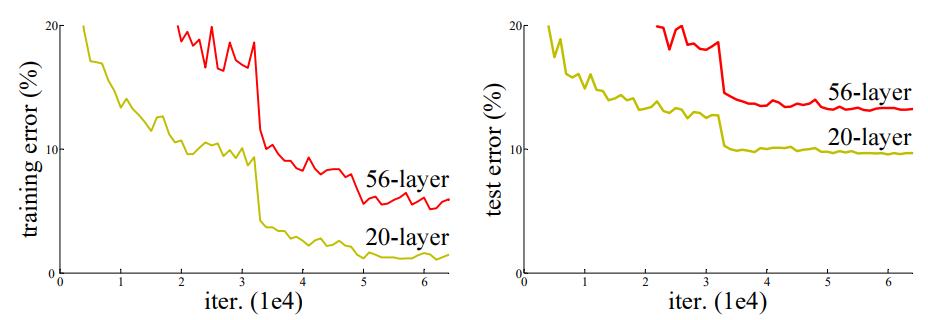

Тогда Kaming He и его команда решили дать сети возможность самой выбирать глубину

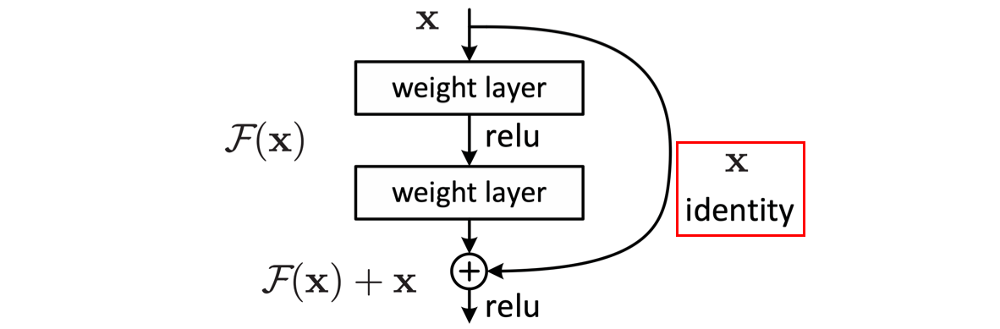

ResNet решает сразу две проблемы:
1. Градиенты больше не затухают
$$y = x + F(x) \\ \frac{\partial L}{\partial x} = \frac{\partial L}{\partial y}\frac{\partial y}{\partial x} = \frac{\partial L}{\partial y}(1 + \frac{\partial F}{\partial x})$$
2. Глубокие сети экспоненциально медленнее сходятся. Теперь мы позволили сети самой обучать глубину

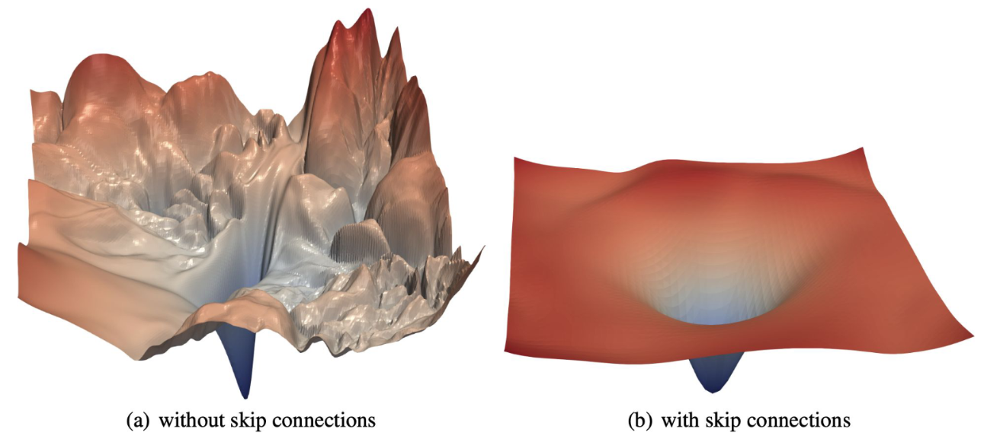

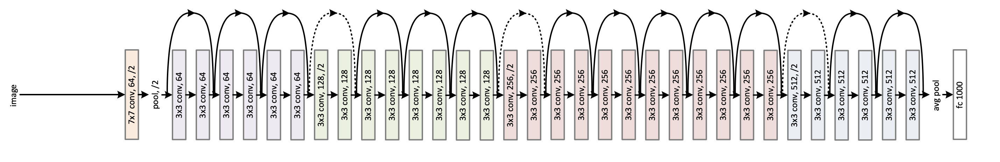

### Улучшение ResNet: Stochastic Depth (2016) - аналог Dropout

Skip connection:
$$y = x + F(x)$$
Skip connection со stochastic depth
$$y = hF(x) + x, \quad h \in  \{0, 1\}$$

## PolyNet (2016)

Можно обучать не только $y = x + F(x)$
$$(I + F)x = x + F(x)$$
$$(I + F + F^2)x = x + F(x) + F(F(x))$$

Параметры в F одни и те же.

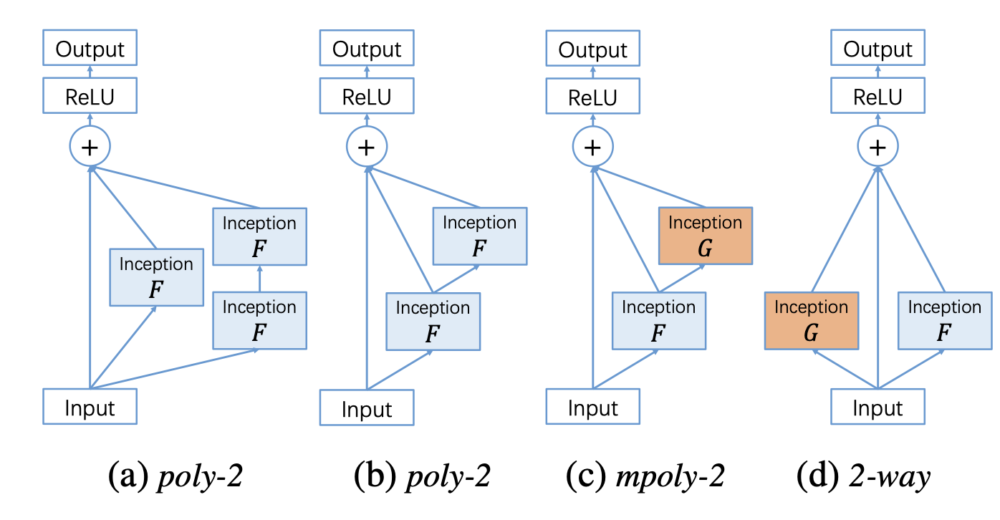

## DenseNet (2016)

1. Сеть состоит из densenet-блоков, в которых каждые два слоя соединены между собой
2. Аггрегирование происходит с помощью конкатенации по каналам
3. Сверточные слои с небольшим числом каналов

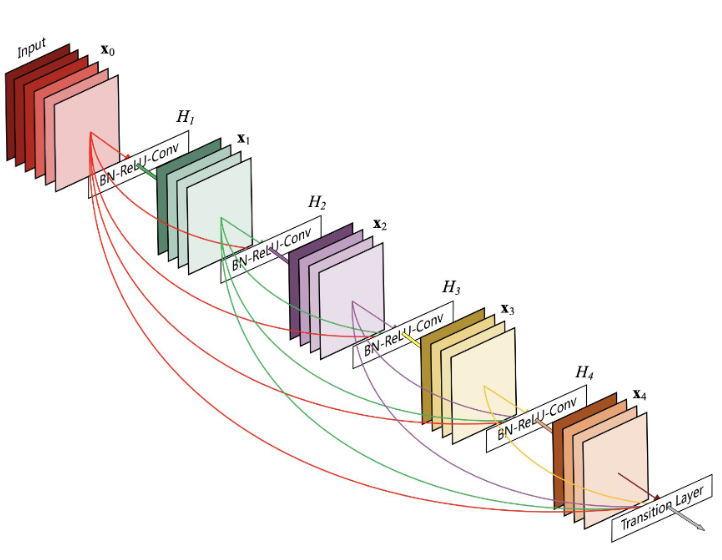

## Обобщение CNN

Есть множество объектов. Каждый объект имеет структуру заданную графом.


*   Определеим свертку по локальной окрестности вершины
*   Определим пуллинг как аггрегацию векторов вершин локальной окрестности

Такая может обучаться находить и классифицировать подграфы.


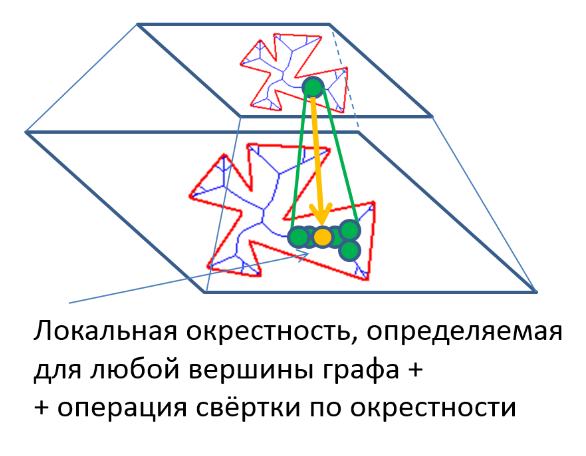

# Supervised Fine-Tuning (SFT)

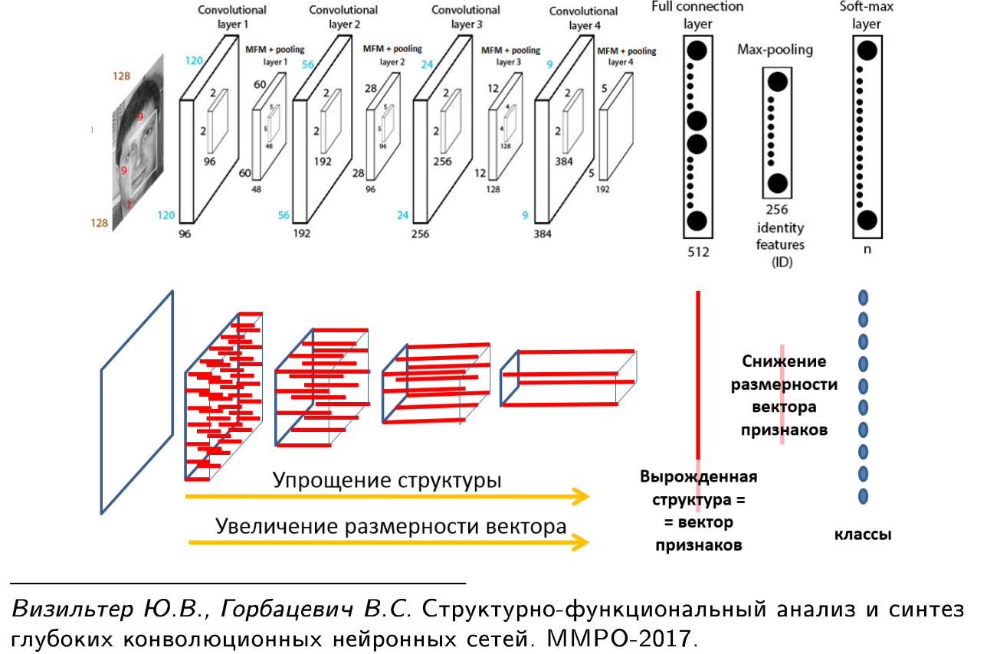

# Рекурентные нейронные сети

## Архитектуры

### Elman RNN (1990)

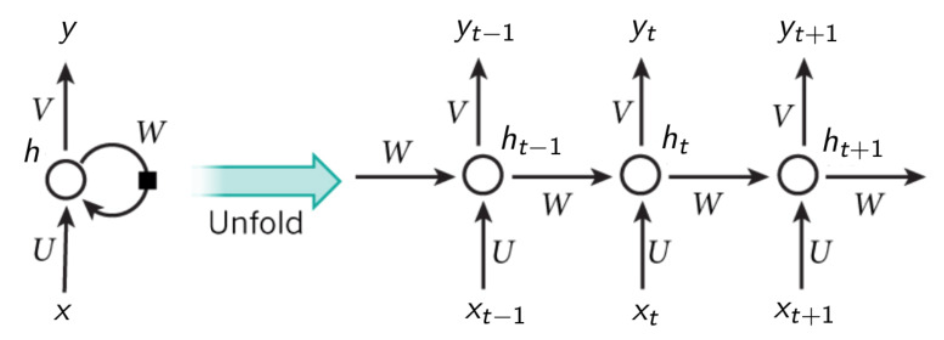

$$ h_t = \sigma \left( Ux_t + b_U+ Wh_{t-1} + b_W\right) $$
$$ y_t = \sigma \left( Vh_t + b_V\right) $$

### LSTM (1997)

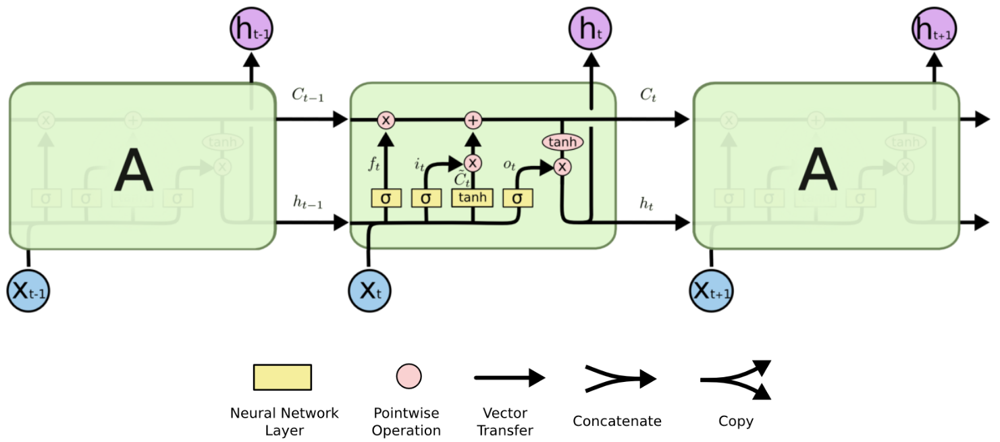

$$\newcommand{\mathleft}{\@fleqntrue\@mathmargin0pt}
{
f_t = \sigma\left( W_f \cdot \left[ h_{t-1}, x_t \right] + b_f \right) \quad \text{---} \quad \text{фильтр забвения (forget gate)} \\
i_t = \sigma\left( W_i \cdot \left[ h_{t-1}, x_t \right] + b_i \right) \quad \text{---} \quad \text{фильтр входных данных (input gate)} \\
o_t = \sigma\left( W_o \cdot \left[ h_{t-1}, x_t \right] + b_o \right) \quad \text{---} \quad \text{фильтр выходных данных (output gate)} \\
\tilde{C}_t = \tanh \left( W_c \cdot \left[ h_{t-1}, x_t \right] + b_c \right) \quad \text{---} \quad \text{модель нового контекста} \\
C_t = f_t \odot C_{t-1} + i_t \odot \tilde{C}_t \quad \text{---} \quad \text{новые долгосрочные данные} \\
h_t = o_t \cdot \tanh(C_t) \quad \text{---} \quad \text{новые краткосрочные данные} \\
}$$


### LSTM with peepholes (2000)

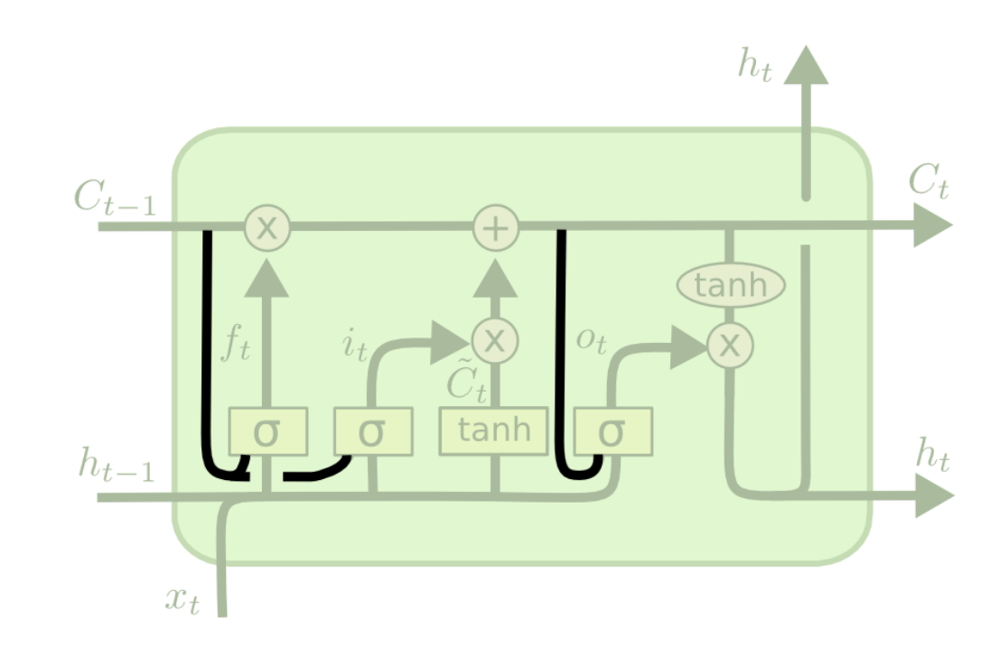

$$\newcommand{\mathleft}{\@fleqntrue\@mathmargin0pt}
{
f_t = \sigma\left( W_f \cdot \left[ C_{t-1},  h_{t-1}, x_t \right] + b_f \right) \quad \text{---} \quad \text{фильтр забвения (forget gate)} \\
i_t = \sigma\left( W_i \cdot \left[ C_{t-1}, h_{t-1}, x_t \right] + b_i \right) \quad \text{---} \quad \text{фильтр входных данных (input gate)} \\
o_t = \sigma\left( W_o \cdot \left[ C_t, h_{t-1}, x_t \right] + b_o \right) \quad \text{---} \quad \text{фильтр выходных данных (output gate)} \\
\tilde{C}_t = \tanh \left( W_c \cdot \left[ h_{t-1}, x_t \right] + b_c \right) \quad \text{---} \quad \text{модель нового контекста} \\
C_t = f_t \odot C_{t-1} + i_t \odot \tilde{C}_t \quad \text{---} \quad \text{новые долгосрочные данные} \\
h_t = o_t \cdot \tanh(C_t) \quad \text{---} \quad \text{новые краткосрочные данные} \\
}$$


### Gated Recurrent Unit (GRU) (2014)

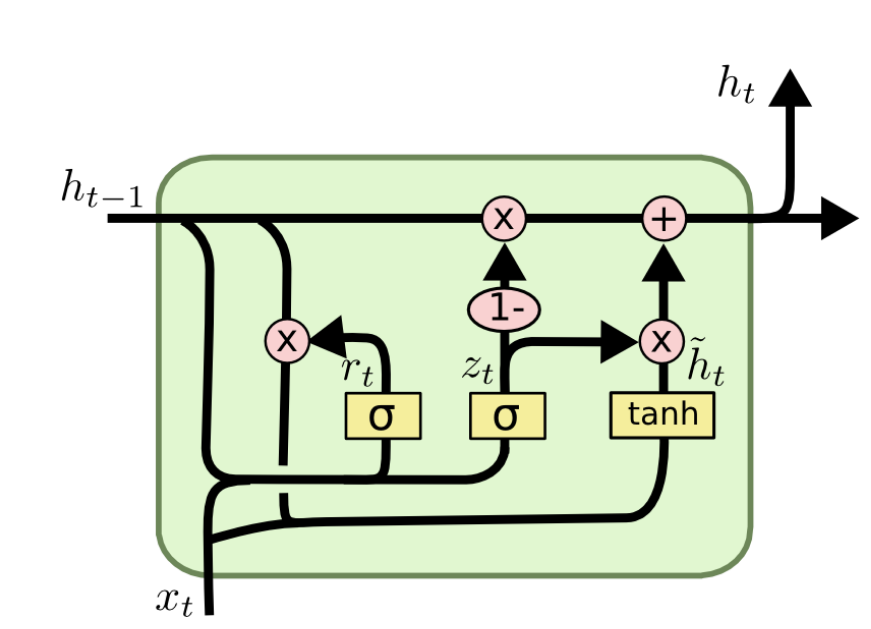

$$\newcommand{\mathleft}{\@fleqntrue\@mathmargin0pt}
{
z_t = \sigma\left( W_z \cdot \left[h_{t-1}, x_t \right] + b_z \right) \quad \text{---} \quad \text{фильтр обновления} \\
r_t = \sigma\left( W_r \cdot \left[h_{t-1}, x_t \right] + b_r \right) \quad \text{---} \quad \text{фильтр перезагнрузки} \\
\tilde{h}_t = \tanh \left( W_h \cdot \left[ r_t \cdot h_{t-1}, x_t \right] + b_h \right) \\
h_t = \left( 1- z_t \right) \odot h_{t-1} + z_t \odot \tilde{h}_t \quad \text{---} \quad \text{новый вектор информации} \\
}$$


[Greff, et al., LSTM: A Search Space Odyssey (2015)](https://arxiv.org/abs/1503.04069)- обзорная статья с большим колличеством сравнений разных вариантов LSTM

### Simple Recurrent Unit (SRU) (2018)

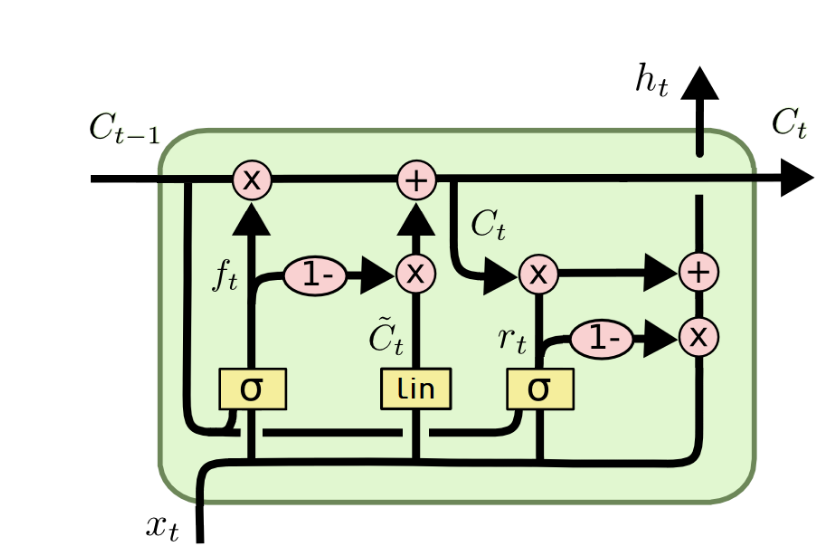

$$\newcommand{\mathleft}{\@fleqntrue\@mathmargin0pt}
{
f_t = \sigma\left( W_f x_t + v_f \odot C_{t-1} + b_f \right) \quad \text{---} \quad \text{forget gate} \\
r_t = \sigma\left( W_r x_t + v_r \odot C_{t-1} + b_r \right) \quad \text{---} \quad \text{reset gate} \\
\tilde{C}_t = W_c x_t \\
C_t = f_t \odot C_{t-1} + \left(1 - f_t\right) \odot \tilde{C}_t \quad \text{---} \quad \text{новые долгосрочные данные} \\
h_t = r_t \odot C_{t} + \left(1 - r_t\right) \odot {x}_t
}
$$


### Long Expressive Memory for Sequence Modeling (LEM) (2021)

Подход без явных гейтов. Данные могут содержать информацию на разных "временных уровнях". Модель должна их выявлять и подстраиваться.   
Статья - [T. Konstantin Rusch et al., 2021](https://arxiv.org/abs/2110.04744)  
Гитхаб - https://github.com/tk-rusch/LEM

# Практика

На основе семинара из курса К.В. Воронцова

In [ ]:
import numpy as np
import pandas as pd
import torch
from tqdm.notebook import tqdm
import requests

from torch.utils.tensorboard import SummaryWriter

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

## Aux functions

In [ ]:
def batch_generator(dataset, char2idx, batch_size=64, shuffle=True):
    X, Y = dataset[:-1], dataset[1:]

    PAD = char2idx['<PAD>']
    n_samples = len(X)

# генерим список индексов
    list_of_indexes = np.linspace(
        0, n_samples - 1, n_samples, dtype=np.int64)
    List_X = []
    List_Y = []

# если нужно перемешать, то перемешиваем
    if shuffle:
        np.random.shuffle(list_of_indexes)


# сгенерируем список индексов, по этим индексам,
# сделаем новый перемешаный спиисок токенов и тэгов
    for indx in list_of_indexes:
        List_X.append(X[indx])
        List_Y.append(Y[indx])

    n_batches = n_samples//batch_size
    if n_samples%batch_size != 0:
        n_batches+=1

    # For each k yield pair x and y
    for k in range(n_batches):
# указываем текущии размер батча
        this_batch_size = batch_size

# если мы выдаем последний батч, то его нужно обрезать
        if k == n_batches - 1:
            if n_samples%batch_size > 0:
                this_batch_size = n_samples%batch_size

        This_X = List_X[k*batch_size:k*batch_size + this_batch_size]
        This_Y = List_Y[k*batch_size:k*batch_size + this_batch_size]

        This_X_line = [
                       [char2idx.get(char, 0) for char in sent]\
                       for sent in This_X]
        This_Y_line = [
                       [char2idx.get('<START>', 0)]\
                       + [char2idx.get(char, 0) for char in sent]\
                       + [char2idx.get('<FINISH>', 0)]\
                       for sent in This_Y]

        List_of_length_x = [len(sent) for sent in This_X_line]
        length_of_sentence_x = max(List_of_length_x)
        List_of_length_y = [len(sent) for sent in This_Y_line]
        length_of_sentence_y = max(List_of_length_y)

        x_arr = np.ones(shape=[this_batch_size, length_of_sentence_x])*PAD
        y_arr = np.ones(shape=[this_batch_size, length_of_sentence_y])*PAD

        for i in range(this_batch_size):
            x_arr[i, :len(This_X_line[i])] = This_X_line[i]
            y_arr[i, :len(This_Y_line[i])] = This_Y_line[i]

        x = torch.LongTensor(x_arr)
        y = torch.LongTensor(y_arr)
        lengths = torch.LongTensor(List_of_length_x)

        yield x, y

In [ ]:
def train_on_batch(model, batch_of_x, batch_of_y, optimizer, loss_function):
    encoder, decoder = model
    encoder.train()
    decoder.train()
    encoder.zero_grad()
    decoder.zero_grad()

    d, h, c = encoder(batch_of_x.to(encoder.device))
    output = decoder(
        batch_of_y.to(decoder.device),
        h=h.to(decoder.device)[:, -decoder.num_layers:, :],
        c=c.to(decoder.device)[:, -decoder.num_layers:, :])

    loss = loss_function(output[:, :-1, :].transpose(1, 2), batch_of_y.to(decoder.device)[:, 1:])

    loss.backward()
    optimizer.step()

    return loss.cpu().item()

In [ ]:
def train_epoch(train_generator, model, loss_function, optimizer, callback = None):
    epoch_loss = 0
    total = 0
    for it, (batch_of_x, batch_of_y) in enumerate(train_generator):
        local_loss = train_on_batch(
            model, batch_of_x, batch_of_y, optimizer, loss_function)

        if callback is not None:
            callback(model, local_loss)

        epoch_loss += local_loss*len(batch_of_x)
        total += len(batch_of_x)

    return epoch_loss/total

In [ ]:
def trainer(count_of_epoch,
            batch_size,
            model,
            dataset,
            char2idx,
            loss_function,
            optimizer,
            callback = None):
    iterations = tqdm(range(count_of_epoch))

    for it in iterations:
        optima = optimizer

        number_of_batch = len(dataset)//batch_size + (len(dataset)%batch_size>0)
        generator = batch_generator(dataset, char2idx, batch_size)

        epoch_loss = train_epoch(
            train_generator = generator, model = model,
            loss_function = loss_function,
            optimizer = optima)

        iterations.set_postfix({'train epoch loss': epoch_loss})

## Callback

In [ ]:
%load_ext tensorboard
%tensorboard --logdir experiment/

<IPython.core.display.Javascript object>

In [ ]:
class callback():
    def __init__(self, writer):
        self.step = 0
        self.writer = writer

    def forward(self, model, loss):
        self.step += 1
        self.writer.add_scalar('LOSS/train', loss, self.step)

    def __call__(self, model, loss):
        return self.forward(model, loss)

## Model

In [ ]:
class Encoder(torch.nn.Module):
    @property
    def device(self):
        return next(self.parameters()).device

    def __init__(self,
                 vocab_dim,
                 emb_dim = 10,
                 hidden_dim = 10,
                 num_layers = 3,
                 bidirectional = False):
        super(Encoder, self).__init__()

        self.num_direction = int(bidirectional + 1)
        self.emb_dim = emb_dim
        self.hidden_dim = hidden_dim

        self.embedding = torch.nn.Embedding(vocab_dim, emb_dim)

        self.encoder = torch.nn.LSTM(
            emb_dim, hidden_dim, num_layers, bidirectional = bidirectional)

    def forward(self, input):
        input = self.embedding(input)
        input = torch.transpose(input, 0, 1)
        d, (h, c) = self.encoder(input)
        return d, torch.transpose(h, 0, 1) , torch.transpose(c, 0, 1)

In [ ]:
class Decoder(torch.nn.Module):
    @property
    def device(self):
        return next(self.parameters()).device

    def __init__(self,
                 vocab_dim,
                 output_dim,
                 emb_dim = 10,
                 hidden_dim = 10,
                 num_layers = 3,
                 bidirectional = False):
        super(Decoder, self).__init__()

        self.num_direction = int(bidirectional + 1)
        self.emb_dim = emb_dim
        self.hidden_dim = hidden_dim
        self.output_dim = output_dim
        self.num_layers = num_layers

        self.embedding = torch.nn.Embedding(vocab_dim, self.emb_dim)

        self.decoder = torch.nn.LSTM(
            emb_dim, hidden_dim, num_layers, bidirectional = bidirectional)

        self.linear = torch.nn.Linear(
            self.num_direction*hidden_dim, output_dim)

    def forward(self, real=None, h = None, c = None, max_len = 50):
        batch_size = 1
        if h is not None:
            batch_size = h.shape[0]
        if c is not None:
            batch_size = c.shape[0]
        if real is not None:
            batch_size = real.shape[0]


        if real is not None:
            input = self.embedding(real)

            if h is None:
                h = torch.randn(
                    (batch_size, self.num_layers, self.num_direction*self.hidden_dim)).to(
                        self.device
                    )
            if c is None:
                c = torch.randn(
                    (batch_size, self.num_layers, self.num_direction*self.hidden_dim)).to(
                        self.device
                    )

            input = torch.transpose(input, 0, 1)
            h = torch.transpose(h, 0, 1)
            c = torch.transpose(c, 0, 1)
            d, _ = self.decoder(input, (h, c))
            answers = self.linear(d)
        else:
            input = self.embedding(
                torch.tensor(
                    [[char2idx['<START>']] for _ in range(
                        batch_size)]).long().to(
                        self.device
                    )
                )

            if h is None:
                h = torch.randn(
                    (batch_size, self.num_layers, self.num_direction*self.hidden_dim)).to(
                        self.device
                    )
            if c is None:
                c = torch.randn(
                    (batch_size, self.num_layers, self.num_direction*self.hidden_dim)).to(
                        self.device
                    )

            input = torch.transpose(input, 0, 1)
            h = torch.transpose(h, 0, 1)
            c = torch.transpose(c, 0, 1)

            answers = torch.zeros(
                (max_len, input.shape[1], self.output_dim)).to(
                    self.device)

            for i in range(max_len):
                d, (h, c) = self.decoder(input, (h, c))
                answers[i, :, :] = self.linear(d)[0]
                input = self.embedding(
                    torch.argmax(answers[i:i+1, :, :], dim=-1))

        return torch.transpose(answers, 0, 1)


## Load Data

In [ ]:
text = requests.get(
    'https://raw.githubusercontent.com/andriygav/MachineLearning/master/seq2seq/data/602016.txt').text

In [ ]:
text[:500]

'\n  \n   Warhammer\n   Битвы в Мире Фэнтези: Омнибус\n   Том I\n  \n  \n   \n    История изменений\n   \n   1.0 — книга произведена в Кузнице книг InterWorld\'а.\n   1.1 — добавлен роман Уильяма Кинга "Истребитель великанов".\n   1.2 — исправлены некоторые ошибки.\n  \n  \n   \n    Время Легенд\n   \n   \n    \n     Гэв Торп\n     История Раскола\n    \n    \n     \n      Малекит\n     \n     \n      Ни одно из событий Времени легенд не является столь значимым и одновременно столь презренным, как падение Малекита. История е'

In [ ]:
char2idx = {'<PAD>':0, '<UNK>': 1, '<START>': 2, '<FINISH>': 3}
idx2char = {0: '<PAD>', 1: '<UNK>', 2: '<START>', 3: '<FINISH>'}
for item in list(set(text)):
    char2idx[item] = len(char2idx)
    idx2char[char2idx[item]] = item


In [ ]:
dataset = [sent.strip() for sent in text.split('\n') if len(sent.strip()) > 20 and len(sent.strip()) < 300 ]
len(dataset)

34076

In [ ]:
dataset[10:15]

['Князь Малекит узнает о своей судьбе',
 'Нарушенное престолонаследование',
 'Каледор увидел, как, прикоснувшись к темному мечу, выкованному для бога убийства, Аэнарион разбудил кровожадный дух, спавший глубоко в душах эльфов. Сильнее, чем в любом другом, в роду Аэнариона пробудилась жажда войны, и мирные времена Вечной королевы навсегда остались позади.',
 'Аэнарион потянулся к мечу от отчаяния и гнева, и зов проклятого оружия терзал его до того дня, когда он перед смертью вернул клинок на алтарь Каина. То же отчаяние подвигло его жениться на провидице Морати, которую Король-Феникс спас из лап Хаоса.',
 'Волшебница Морати жаждала покорить великую энергию, выпущенную в мир Хаосом. Некоторые считали ее занятия опасной ересью, по острову ходили слухи, что Морати приворожила Аэнариона. Многим казалось, что она рвется к власти, но Аэнарион не слушал их предостережений.']

## Init model

In [ ]:
encoder = Encoder(vocab_dim=len(char2idx),
                  num_layers=2, emb_dim=100, hidden_dim=100)
encoder.to(device)
decoder = Decoder(vocab_dim=len(char2idx),
                  output_dim=len(char2idx), num_layers=2, emb_dim=100, hidden_dim=100)
decoder.to(device)

optimizer = torch.optim.Adam(
    list(encoder.parameters()) + list(decoder.parameters()), lr=1e-3)
loss_function = torch.nn.CrossEntropyLoss(ignore_index=char2idx['<PAD>'])

In [ ]:
for _ in range(10):
    indexes = torch.argmax(
        decoder(max_len=100,
                h=0.1*torch.randn(
                    (1, decoder.num_layers, decoder.num_direction*decoder.hidden_dim)).to(
                        decoder.device
                ),
                c=torch.randn(
                    (1, decoder.num_layers, decoder.num_direction*decoder.hidden_dim)).to(
                    decoder.device
                )), dim=-1).detach().cpu().numpy()[0]
    list_of_char = []
    for idx in indexes:
        if idx == char2idx['<FINISH>']:
            break
        list_of_char.append(idx2char[idx])
    print(''.join(list_of_char))

"""ъбъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъбб
uМббббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъ
––ъъъъбббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъб
}}ъъбббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъ
((((ббббббббъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъ
  G(ММЕ7yyъъббъбъбъбъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъбб
BBBЩЩъ2ъъбббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъбб
2Ч77ъъъбббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъ
иифффффффффффф77yyъъ2ъбббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъб
,,,bbb((Мббббббъббъбъбъбъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъббъъб

## Train

In [ ]:
writer = SummaryWriter(log_dir = 'experiment')

call = callback(writer)

In [ ]:
trainer(count_of_epoch = 100,
        batch_size = 64,
        model = (encoder, decoder),
        dataset = dataset,
        char2idx = char2idx,
        loss_function = loss_function,
        optimizer = optimizer,
        callback=call)

  0%|          | 0/100 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
for _ in range(10):
    indexes = torch.argmax(
        decoder(max_len=100,
                h=0.1*torch.randn(
                    (1, decoder.num_layers, decoder.num_direction*decoder.hidden_dim)).to(
                        decoder.device
                ),
                c=torch.randn(
                    (1, decoder.num_layers, decoder.num_direction*decoder.hidden_dim)).to(
                    decoder.device
                )), dim=-1).detach().cpu().numpy()[0]
    list_of_char = []
    for idx in indexes:
        if idx == char2idx['<FINISH>']:
            break
        list_of_char.append(idx2char[idx])
    print(''.join(list_of_char))

лижжыть? — закричал он. — Не видел в сторону столь возможность странным страха.
хсчоу-голя не поняли с ними.
ШЕДТАЯ
ШГЕАДЬОА ДЕСЬ ДУМАЕШЬ, ЧЕМ ПОАтДУИТЬ ШТЬСЫ
лижжыгая короля он поднял голову и поднял голову и поднял голову и поднял голову и поднял голову и п
х32ackm
хщуался она поднялись на него.
лиe) ты положил в сторону столь просто подобного стражники.
встальть воды в сторону столь просто подобного стражники.
лишеемуя возможности возможность странным страха.


# Дополнительно. Поговорим про оптимизацию

## Метод градиентного спуска
* Идея метода - идти в сторону антиградиента функции потерь
* Эмпирический риск:
$$Q(w) = \sum_{i=1}^l ℒ (w, x_i) → \min_w$$
1. $w^{(0)}$ - начальное приближение
2. $w^{(t+1)} := w^{(t)} - \eta\nabla Q(w^{(t)}) = w^{(t)} - \eta\frac{1}{l} \sum_{k = 1}^l \nabla q_k(w^{(t)})$


### Его проблемы
1. Долго вычислять градиент по всей выборке
2. Единстенный регулиремый парамет - learning rate
3. Ландшафт функции потерь ([Красивая визуализация](https://losslandscape.com/)). (! На самом деле, ландшафт многомерной ф-ии потерь не похож на параболу, скорее он представляет из себя "пространство с тоннелями", подробнее здесь: https://vk.com/video-22522055_456245617)




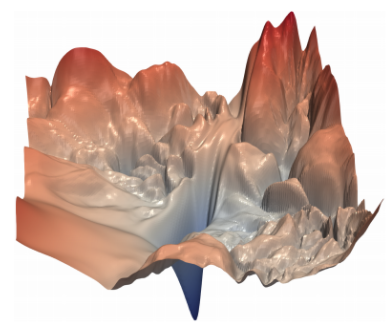

#### Локальный минимум

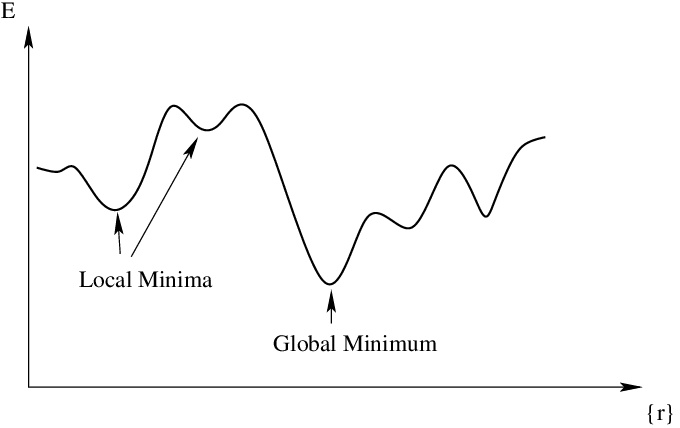

* При определенных условиях (*т.н. широкие сети*) все локальные минимумы могут быть глобальны.
* Локальный минимум означает, что все собственные значения матрицы Гессе положительны. А для седловой точки есть как положительние, так и отрицательные значения. В n-мерном случае вероятность встретить локальный минимум экспоненциально убывает с ростом n ([Goodfellow, Deep Learning Book, 8.2.2 Local Minima](https://www.deeplearningbook.org/contents/optimization.html#:~:text=8.2.2,Minima)).

#### Седловая точка

Такая точка, в которой в одном направлении, соответствующем одному параметру, кривая находится на локальном минимуме (показано зеленым цветом); во втором же направлении, соответствующем другому параметру, кривая находится на локальном максимуме (показано красным цветом).

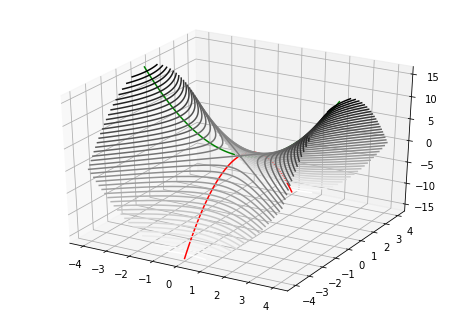

#### Овраги

Довольно часто овраг приводит к хорошему минимуму. Но вместо того, чтобы двигаться по убыванию функции в протяженной стороне, градиентный спуск осциллирует в овраге

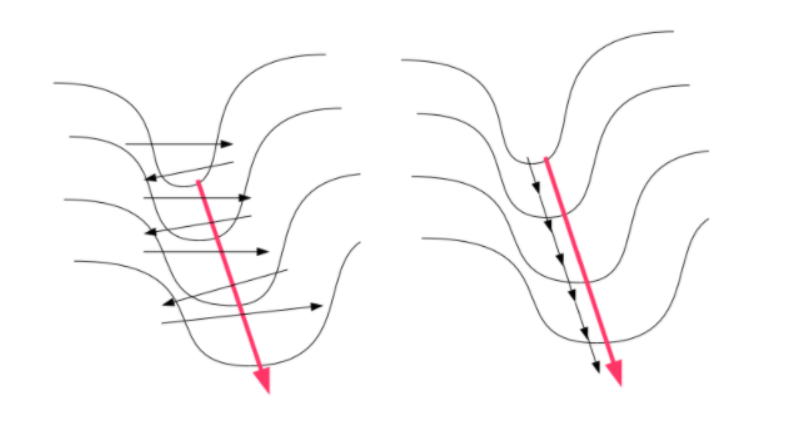

#### Утесы и взрыв градиента

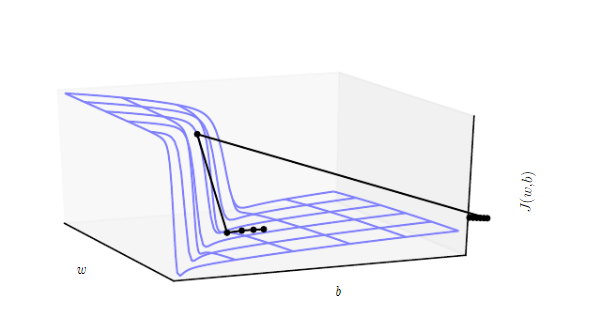

#### "Узкие локальные минимумы"

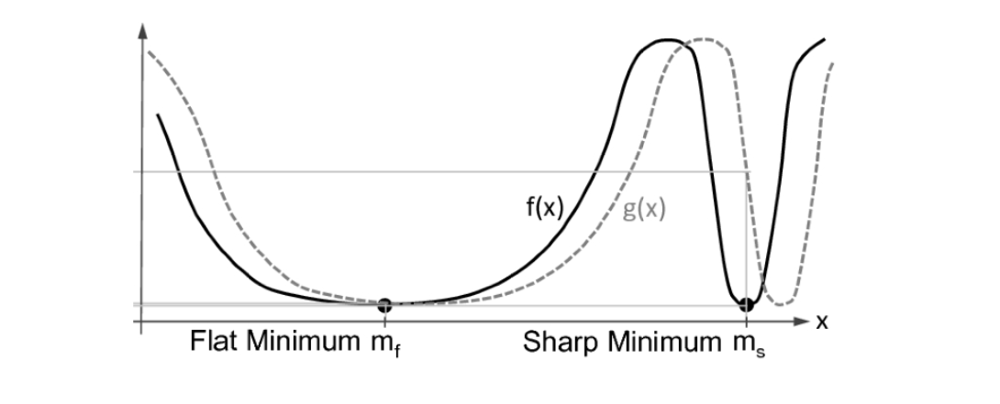

Здесь $f(x)$ – ландшафт функции потерь на обучающей выборке,  $g(x)$ – ландшафт функции потерь на тестовой выборке. Можно увидеть, что острый узкий минимум почти исчезает при таком переходе, а широкий все так же виден, как и раньше.

[Примеры с анимацией](https://fa.bianp.net/teaching/2018/eecs227at/gradient_descent.html)

### SGD is all you need?

$$\nabla Q(X, w^{(t)}) ≈ \frac{1}{n} \sum_{k = 1}^n \nabla q(x_k, w^{(t)}) = \frac{1}{n} \sum_{k = 1}^n \nabla q_k(w^{(t)})$$
* где $n$ – batch size

При использовании SGD неожиданные преимущества:
1. Метод хорошо обходит седловые точки.
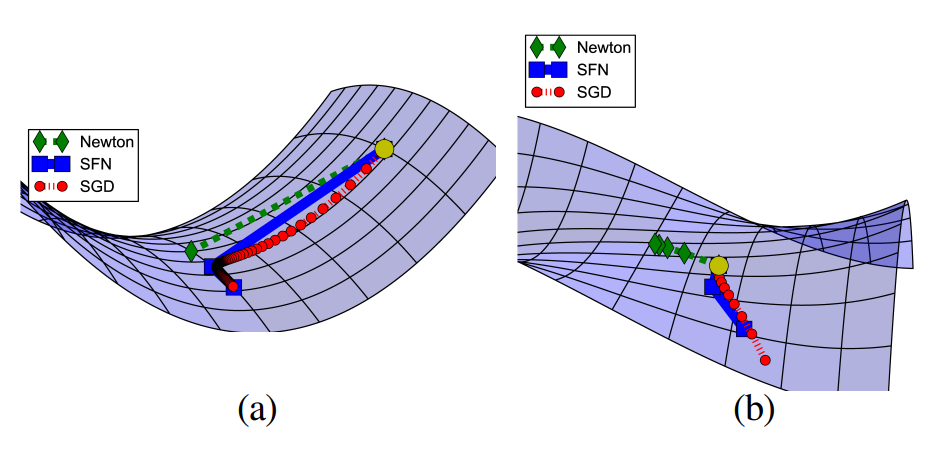
2. Справляется с "узкими" локальными минимумами.

[Тоже есть визуализация](https://fa.bianp.net/teaching/2018/eecs227at/stochastic_gradient.html)

### Momentum

Воспользуемся интуицией из физики: за счет инерции шарик катящийся по склону не будет застревать на неровностях.

$$h_k = \alpha h_{k-1} + (1-τ)\nabla_w Q(X, w_k)$$
$$θ_k = θ_{k-1} - ηh_k$$

* $α$ – определяет влияние импульса
* $\tau$ может равняться нулю

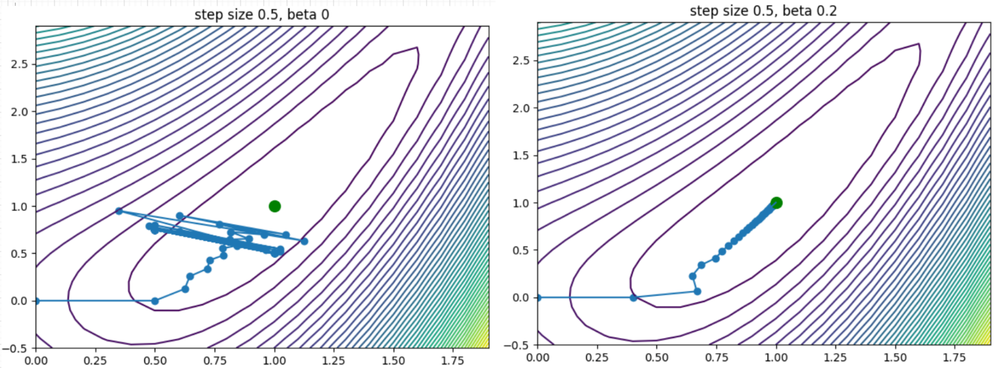

Значения momentum (то есть, $α$) тоже нужно подбирать (оно должно быть от 0 до 1)

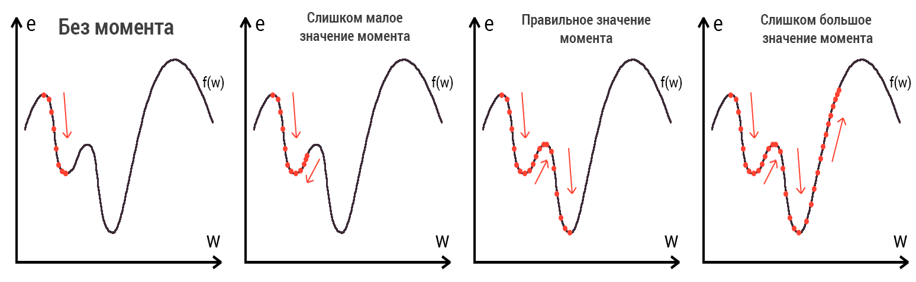

### Adagrad (2011)

Пытаемся адаптивно изменять скорость обучения, причем по всем координатам.
$$
\begin{eqnarray}
g &=&\nabla_wQ(X, w) \\
G &=& G + diag(gg^{T}) \\
w &=& w - \frac{\eta}{\sqrt{G+ɛ}} \odot g
\end{eqnarray}
$$

Алгоритм нацелен компенсировать слишком большие или слишком маленькие координаты градиента.

*Есть проблема: алгоритм не устойчив к взрывам градиента и к плохим начальным оптимизациям.*

Алгоритм плохо подходит для старых больших архитектур, без skip connection и прочих методов регуляризации.

### RMSProp

Заменим сумму выпуклой комбинацией.
$$
\begin{eqnarray}
G &=& \alpha G + (1 - \alpha) diag(gg^{T}) \\
w &=& w - \frac{\eta}{\sqrt{G+ɛ}} \odot g
\end{eqnarray}
$$

### Adam (2014)

Совместим AdaGrad и Momentum

$$
\begin{eqnarray}
m &=& \beta_1 m + (1 - \beta_1) g \\
v &=& \beta_2 v + (1 - \beta_2) diag(gg^{T}) \\
\hat{m} &=& \frac{m}{1 - \beta_1^{k}} \\
\hat{v} &=& \frac{v}{1 - \beta_2^{k}} \\
w &=& w - \frac{\eta}{\sqrt{\hat{v} + \varepsilon}} \odot \hat{m}
\end{eqnarray}
$$

Adam хорошо подходил для обучения старых архитектур.

Но:
1. Есть выпуклые примеры (даже одномерные), где adam расходится.
2. На начальных итерациях из-за bias correction могут быть проблемы.
3. Есть проблема блуждания в области около точки локального минимума.

Одно из возможных решений – использование learning rate scheduale.

### AMSGrad (2018)

Попытка "починить" adam.
$$
\begin{eqnarray}
v &=& \beta v + (1 - \beta) diag(gg^{T}) \\
\hat{v} &=& \max(v, \hat{v}) \\
w &=& w - \frac{\eta}{\sqrt{\hat{v} + \varepsilon}} \odot g
\end{eqnarray}
$$

Можно добавить *momentum* заменив g в последнем выражении на m.

Алгоритм требует занительно больше памяти, требуется хранить $v$ и $\hat{v}$. Есть простая эвристика:  
заменяем $v_t=\max(v_t, v_{t-1})$

**Можно добавить bias correction как в Adam**
1. Post-correction: $\hat{v} = \left(1-𝛽^k\right)^{-1} \max(v, \hat{v})$
1. Pre-correction: $\hat{v} = \max\left(\frac{v}{\left(1-𝛽^k\right)}, \frac{\hat{v}}{\left(1-𝛽^{k-1}\right)}\right)$

Подробнее здесь: https://education.yandex.ru/handbook/ml/article/metody-optimizacii-v-deep-learning

# Уже многое реализованное в PyTorch

In [ ]:
import torch

In [ ]:
torch.optim.SGD()
torch.optim.SGD(momentum=0.1)
torch.optim.Adagrad()
torch.optim.RMSprop()
torch.optim.Adam()
torch.optim.Adam(amsgrad=True)

# Изменение расписание скорости обучения

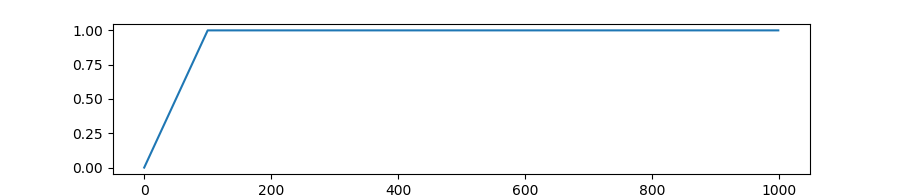

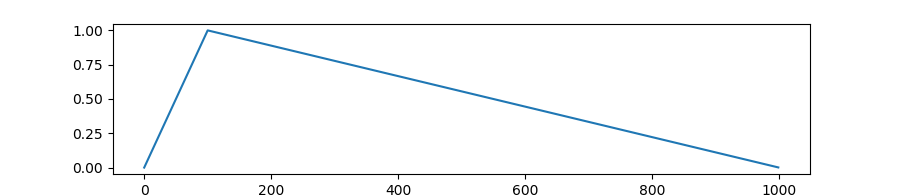

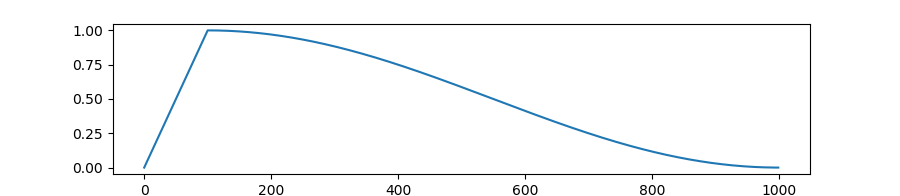

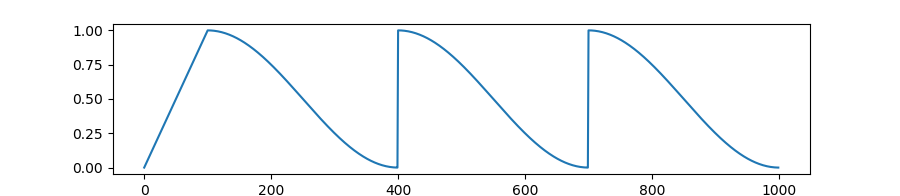

# Curriculum learning (обучение по расписанию)
Человек учиться по системе от "простого к сложному", сначало изучаются простые концепты и примеры, затем идут все более сложные.  
Можно попробовать применить это в обучении нейронных сетей.

Формальная постановка из оригинальной статьи (Bengio Y. et al. Curriculum learning, 2009):

Пусть $z$ – объект из обучающей выборки. $P\!\left(z\right)$ – некоторое целевое распределение данных. И пусть $0\leq W_λ \! \left(z\right) \leq 1$ есть вес наблюдения (где $0\leq λ \leq 1$ – шаг расписания). Распределение данных на шаге расписания $\lambda$:  
$$Q_λ \left(z\right) = W_λ \left(z\right) P_λ \left(z\right) \quad ∀z,$$  
причем $∫Q_λ \!\left(z\right)dz = 1$

Тогда **расписанием** назавем последовательность $Q_λ$ если выполняются следующие 2 условия:  
$$H\left( Q_λ \right) < H \left( Q_{λ+ϵ} \right) \quad ∀ϵ > 0 $$
$$W_{λ+ϵ} \geq W_{λ}  \quad ∀ϵ > 0 $$

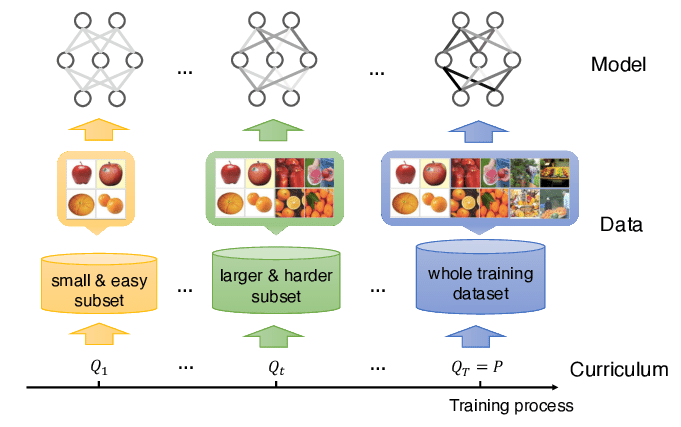